In [32]:
from pathlib import Path
import csv
from collections import defaultdict
import os.path
from statistics import mean 
import pandas as pd
import altair as alt
import fiona
import geopandas as gpd
import gpdvega

In [29]:
alt.renderers.enable('notebook')
alt.themes.enable('opaque')
alt.data_transformers.enable('gpd_to_values')

DataTransformerRegistry.enable('gpd_to_values')

In [3]:
def read_csv(filename):
    with open(filename, newline='') as File:  
        reader = csv.reader(File)
        header1 = next(reader)
        header2 = next(reader)
        results = []
        for row in reader:
            folder = Path(row[0].strip("'"))
            parts = folder.parts
            if len(parts) > 2 and parts[-1].lower().endswith('.tif'):
                results.append({"folder": str(folder.parent), "hits": int(row[1]), "bytes": int(row[2]), "cost": float(row[3])})
        return results

In [4]:
all_entries = read_csv("Files_20190417_20190423.csv")

In [5]:
len(all_entries)

23086

In [6]:
def product_name(folder):
    parts = Path(folder).parts
    if parts[0] == 'mangrove_cover':
        return parts[0]
    return os.path.join(*parts[:2])


def spatial_id(folder):
    parts = Path(folder).parts
    if len(parts) > 2 and parts[0] == 'L2' and parts[1] == 'sentinel-2-nrt' and parts[-1] in ['NBAR', 'NBART', 'QA', 'SUPPLEMENTARY', 'LAMBERTIAN']:
        try:
            return parts[-2].split("_")[-2][1:]
        except IndexError:
            print(folder)
    else:
        return '<none>'

def merge_pre(folder, dicts):
    return {
        'hits': max(int(d['hits']) for d in dicts),
        'bytes': sum(int(d['bytes']) for d in dicts),
        'cost': sum(float(d['cost']) for d in dicts),
        'spatial_id': spatial_id(folder),
        'product': product_name(folder),
        'folder': folder
    }

def group(entry_list, key):
    lookup = defaultdict(list)
    
    for d in entry_list:
        lookup[d[key]].append(d)
        
    return lookup
    

def merge(dicts):
    return {
        'hits': sum(int(d['hits']) for d in dicts),
        'bytes': sum(int(d['bytes']) for d in dicts),
        'cost': sum(float(d['cost']) for d in dicts)
    }

In [7]:
stage1 = [merge_pre(key, value) for key, value in group(all_entries, 'folder').items()]

In [8]:
sentinel2 = [d for d in stage1 if d['product'] == 'L2/sentinel-2-nrt']

In [9]:
s2_summary = {key: merge(value)['hits'] for key, value in group(sentinel2, 'spatial_id').items()}

In [10]:
s2_summary_list = list(s2_summary.items())

In [11]:
s2_mgrs = [entry[0] for entry in s2_summary_list]
s2_hits = [entry[1] for entry in s2_summary_list]

In [12]:
hit_values = pd.DataFrame({'MGRS': s2_mgrs, 'hits': s2_hits})

In [14]:
grid = fiona.open('australia-mgrs-grid.geojson')

In [16]:
mgrs_poly = {}

In [17]:
for entry in grid:
    mgrs = entry['properties']['MGRS']
    mgrs_poly[mgrs] = entry

In [18]:
common = set(s2_summary) & set(mgrs_poly)

In [19]:
geojson = [mgrs_poly[x] for x in common]

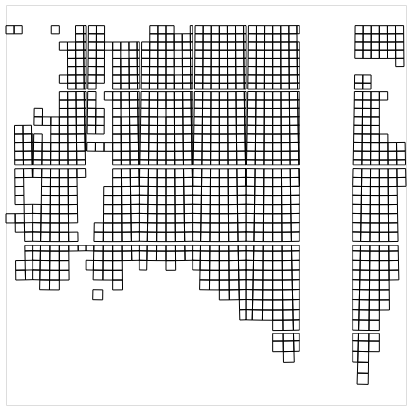

In [20]:
alt.Chart(alt.Data(values=geojson)).mark_geoshape(stroke='black', strokeWidth=1).encode().properties(width=400, height=400)

In [22]:
polygons = gpd.GeoDataFrame.from_features((geojson))

In [23]:
polygons.head()

,100kmSQ_ID,CM,E3,E4,EASTING,FID_GZD_55,GZD,MGRS,N4,NORTHING,SOUTH_LAT,WEST_LONG,geometry,id
0,GJ,None,None,None,700000mE,None,52L,52LGJ,None,8300000mN,None,None,POLYGON ((131.7942661529241 -15.35924993061521...,70
1,WK,None,None,None,500000mE,None,51J,51JWK,None,6900000mN,None,None,POLYGON ((124.0172327751458 -28.02148995090137...,33
2,FB,None,None,None,600000mE,None,49H,49HFB,None,6100000mN,None,None,POLYGON ((113.1975416533983 -35.22312494055522...,22
3,KK,None,None,None,200000mE,None,53J,53JKK,None,6900000mN,None,None,POLYGON ((132.9659270347477 -28.01020024594077...,30
4,MF,None,None,None,400000mE,None,56K,56KMF,None,8000000mN,None,None,"POLYGON ((153 -18.08870894312735, 152.05495305...",19


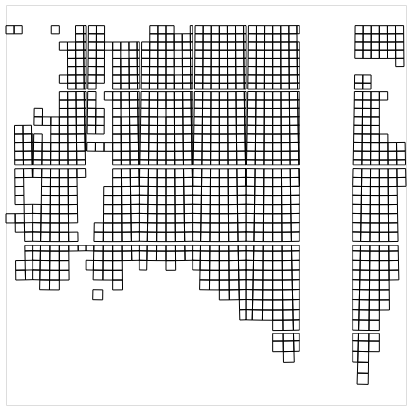

In [31]:
alt.Chart(merged).mark_geoshape(
        stroke='black',
        strokeWidth=1
    ).encode(
    ).properties(
        width=400,
        height=400
    )

In [33]:
merged = polygons.merge(hit_values, on= 'MGRS', how = 'inner')[['geometry', 'hits', 'MGRS']]

ThemeRegistry.enable('opaque')

In [34]:
merged.head()

,geometry,hits,MGRS
0,POLYGON ((131.7942661529241 -15.35924993061521...,386,52LGJ
1,POLYGON ((124.0172327751458 -28.02148995090137...,236,51JWK
2,POLYGON ((113.1975416533983 -35.22312494055522...,108,49HFB
3,POLYGON ((132.9659270347477 -28.01020024594077...,81,53JKK
4,"POLYGON ((153 -18.08870894312735, 152.05495305...",10,56KMF


In [37]:
def gen_map(geodata, color_column, title):
    '''Generates DC ANC map with population choropleth and ANC labels'''
    # Add Base Layer
    base = alt.Chart(geodata, title = title).mark_geoshape(
        stroke='black',
        strokeWidth=1
    ).encode(
    ).properties(
        width=400,
        height=400
    )
    # Add Choropleth Layer
    choro = alt.Chart(geodata).mark_geoshape(
        fill='lightgray',
        stroke='black'
    ).encode(
        alt.Color(color_column, 
                  type='quantitative', 
                 scale=alt.Scale(scheme='bluegreen'),
                 title = "hits")
    )

    return base + choro


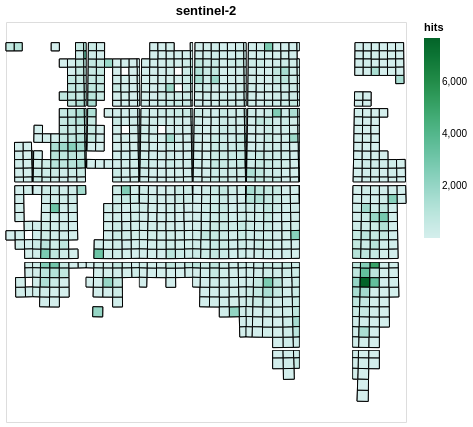

In [38]:
gen_map(merged, 'hits', 'sentinel-2')

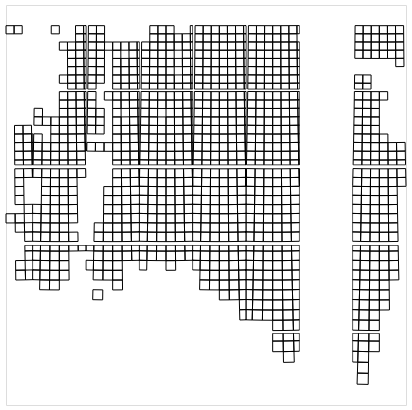

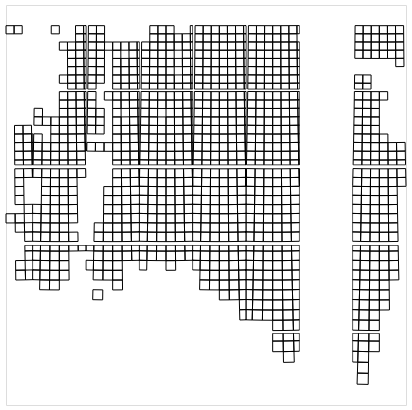

In [44]:

  
def gen_base(geojson):
    '''Generates baselayer of DC ANC map'''
    base = alt.Chart(alt.Data(values=geojson)).mark_geoshape(
        stroke='black',
        strokeWidth=1
    ).encode(
    ).properties(
        width=400,
        height=400
    )
    return base



In [40]:
import requests

In [43]:
geos = "australia-mgrs-grid.geojson"

In [46]:
gen_base(grid)

TypeError: sequence item 1: expected str instance, int found